# Libraries

In [1]:
import pandas as pd

# Load Token distributions

In [2]:
import json
PYTHIA_SUITE = 'standard'

In [3]:
with open(f'{PYTHIA_SUITE}_memorized_frequencies.json', 'r') as f:
    memorized_data = json.load(f)
    memorized_distribution = dict((token, freq) for (token, freq) in enumerate(memorized_data['memorized']))
    non_memorized_distribution = dict((token, freq) for (token, freq) in enumerate(memorized_data['non_memorized']))


In [4]:
all_occs = 0
for token in memorized_distribution.keys():
    all_occs += memorized_distribution[token]

# Calculate token probabilities

In [5]:
memorized_probabilities = {}

In [6]:
from transformers import GPTNeoXTokenizerFast

In [7]:
tokenizer = GPTNeoXTokenizerFast.from_pretrained("EleutherAI/pythia-70m")

In [8]:
from tqdm.auto import tqdm

In [9]:
for (token, tok_id) in tqdm(tokenizer.vocab.items()):
    try:
        memorized_probabilities[token] = memorized_distribution[tok_id] / (memorized_distribution[tok_id] + non_memorized_distribution[tok_id])
    
    except ZeroDivisionError:
        pass

  0%|          | 0/50277 [00:00<?, ?it/s]

# Calculate Memorized Occurances

In [10]:
memorized_occurances = {}

for (token, tok_id) in tqdm(tokenizer.vocab.items()):
    memorized_occurances[token] = memorized_distribution[tok_id] + non_memorized_distribution[tok_id]

  0%|          | 0/50277 [00:00<?, ?it/s]

In [11]:
probabilities = []
occurances = []
tokens = []
for token in tokenizer.vocab.keys():
    try:
        prob = memorized_probabilities[token]
    except KeyError:
        prob = 0
    occ = memorized_occurances[token]
    probabilities.append(prob)
    occurances.append(occ)
    tokens.append(token)

token_dist = pd.DataFrame({
    'fraction memorized': probabilities,
    'occurances': occurances,
    'tokens': tokens
})

# Looking at most memorized tokens

In [17]:
THRESHOLD = 1
df = token_dist[token_dist['occurances'] >= THRESHOLD].sort_values(by = 'fraction memorized', ascending = False)
df.head(30).style.hide_index()

/tmp/ipykernel_145686/3759979592.py:3: FutureWarning: this method is deprecated in favour of `Styler.hide(axis="index")`
  df.head(30).style.hide_index()


fraction memorized,occurances,tokens
0.993298,497642,NFTA
0.951691,431845,ETHERTYPE
0.922221,505445,IPPROTO
0.902296,533169,TIOC
0.899291,756606,Ā
0.898775,606027,SIOC
0.875379,743941,DLT
0.820448,1010427,Errno
0.742035,506717,ITERATION
0.713899,1695778,Ġsyscall


# Correlation between occurance and probability of tokens

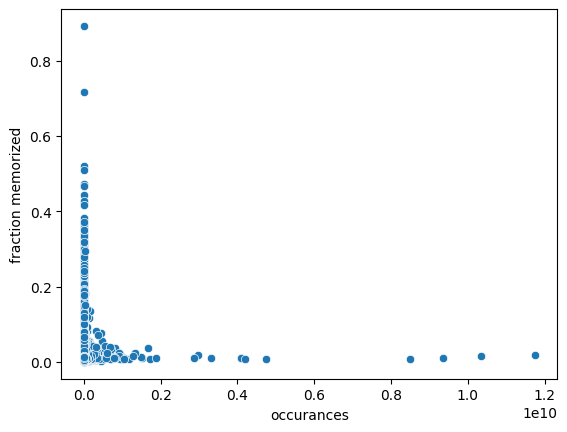

In [41]:
import seaborn as sns
import pandas as pd

fig = sns.scatterplot(token_dist, 
    y = 'fraction memorized', 
    x = 'occurances'
)

In [42]:
import plotly.express as px

In [43]:
px.scatter(token_dist, 
    x = 'occurances', 
    y = 'fraction memorized', 
    title = "Correlation b/w Occurance & Memorization of Tokens",
)

In [44]:
import scipy.stats as stats
kernel = stats.gaussian_kde([token_dist['occurances'], token_dist['fraction memorized']])
cmap = kernel([token_dist['occurances'], token_dist['fraction memorized']])

In [45]:
px.scatter(token_dist, 
    x = 'occurances', 
    y = 'fraction memorized', 
    color = cmap,
    log_x = True,
    title = "Correlation b/w Occurance & Memorization of Tokens",
)

In [19]:
px.histogram(token_dist, 
    x = 'probabilities', 
    y = 'occurances', 
    log_y = True, 
    histfunc = 'max', 
    title = "Correlation b/w Occurance & Memorization of Tokens",
)

In [50]:
px.histogram(token_dist, 
    x = 'probabilities', 
    y = 'occurances', 
    log_y = True, 
    histfunc = 'min', 
    title = "Correlation b/w Occurance & Memorization of Tokens",
)

In [15]:
from wordcloud import WordCloud

In [16]:
import matplotlib.pyplot as plt

plt.rcParams["figure.figsize"] = (30,30)

In [17]:
most_memorized_tokens = sorted([(value, key) for (key, value) in memorized_probabilities.items()])[-5000:]

In [18]:
least_memorized_tokens = sorted([(value, key) for (key, value) in memorized_probabilities.items()])[:5000]

In [19]:
most_memorized_tokens = dict((key, value + 1e-7) for (value, key) in most_memorized_tokens)
least_memorized_tokens = dict((key, 1 - value + 1e-7) for (value, key) in least_memorized_tokens)

(-0.5, 1999.5, 1999.5, -0.5)

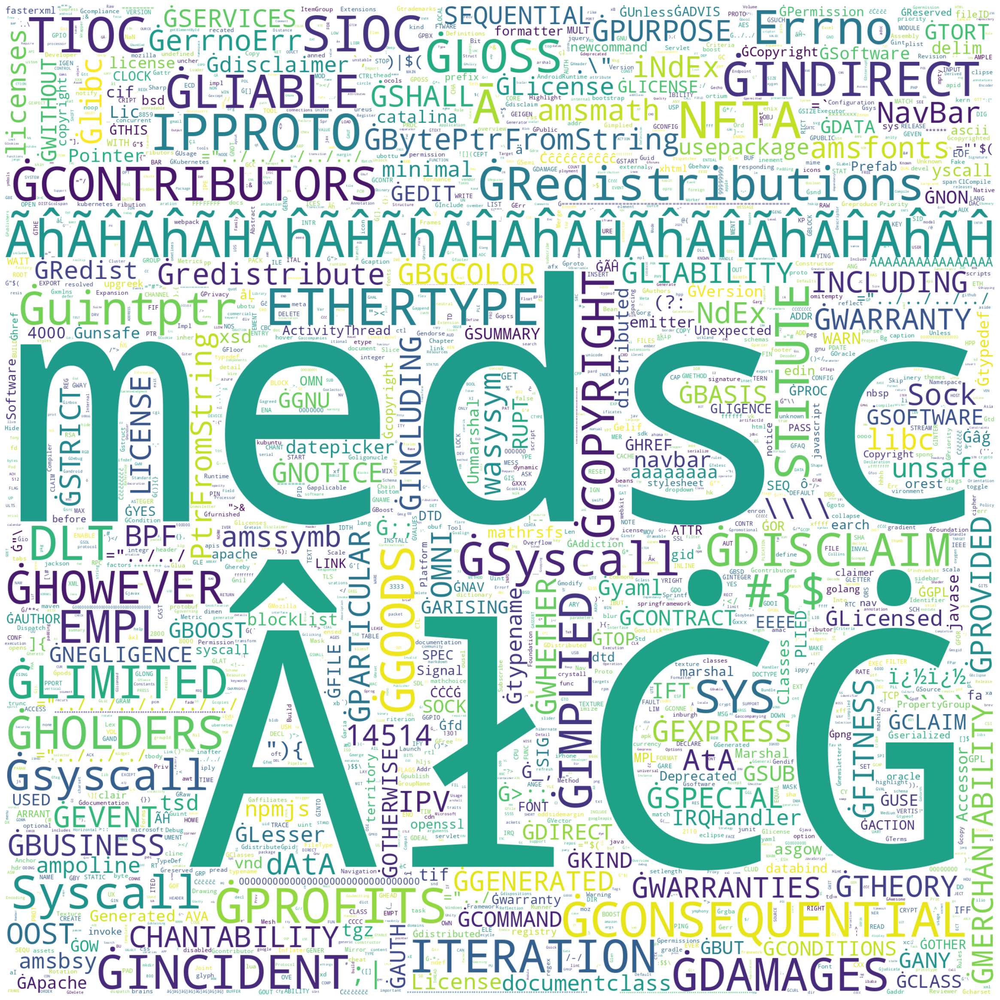

In [40]:
wc = WordCloud(background_color="white", max_words = 5000, width = 2000, height = 2000)
wc.generate_from_frequencies(most_memorized_tokens)

plt.imshow(wc, interpolation = 'bilinear')
plt.axis("off")

(-0.5, 1999.5, 1999.5, -0.5)

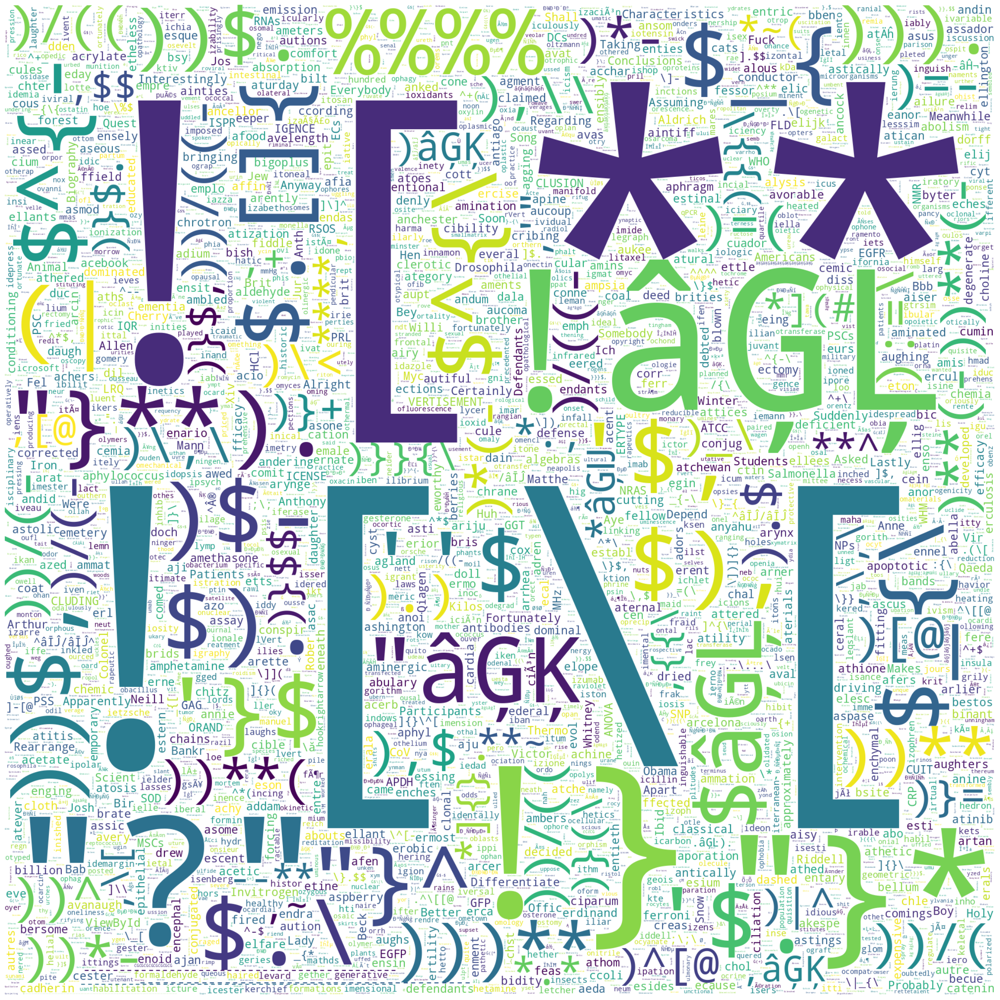

In [41]:
wc = WordCloud(background_color="white", max_words = 5000, width = 2000, height = 2000)
wc.generate_from_frequencies(least_memorized_tokens)

plt.imshow(wc, interpolation = 'bilinear')
plt.axis("off")

In [22]:
sorted(list(most_memorized_tokens.items()), key = lambda x:x[1])[-10:]

[('ĠPROFITS', 0.8702128659574467),
 ('ĠCONSEQUENTIAL', 0.8752736229759299),
 ('TIOC', 0.9093960731543623),
 ('SIOC', 0.9301243236024844),
 ('IPPROTO', 0.9582578132486388),
 ('ETHERTYPE', 0.9833334333333332),
 ('NFTA', 0.9961014645224171),
 ('medsc', 1.0000001),
 ('ÂłĊĠ', 1.0000001),
 ('ÃĥÃĤÃĥÃĤÃĥÃĤÃĥÃĤÃĥÃĤÃĥÃĤÃĥÃĤÃĥÃĤ', 1.0000001)]

In [23]:
sorted(list(least_memorized_tokens.items()), key = lambda x:x[1])[-10:]

[('Ġpromin', 1.0000001),
 ('Ġprominence', 1.0000001),
 ('Ġpromot', 1.0000001),
 ('Ġpromoters', 1.0000001),
 ('Ġprong', 1.0000001),
 ('Ġpropensity', 1.0000001),
 ('Ġprophyl', 1.0000001),
 ('Ġprophylactic', 1.0000001),
 ('Ġproport', 1.0000001),
 ('Ġproposing', 1.0000001)]

In [18]:
import pickle

In [1]:
import sys

In [2]:
sys.path.append("/fsx/orz/gpt-neox/")

In [3]:
from megatron.tokenizer import build_tokenizer

In [4]:
from megatron.data.data_utils import build_the_dataset

In [5]:
config = {
    'deduped': {
        'data_prefix': '/fsx/pile_deduped/pile_0.87_deduped_text_document',
        'idxmap_path': '/fsx/pile_deduped/pile_0.87_deduped_text_document_train_0_indexmap_147164160ns'
    },
    'duped': {
        'data_prefix': '/fsx/pile/pile_20B_tokenizer_text_document',
        'idxmap_path': '/fsx/pile/pile_20B_tokenizer_text_document_test_0_indexmap_10292ns'
    }
}

In [6]:
selected_config = config['duped']

In [7]:
import numpy as np
import pandas as pd
from tqdm.auto import tqdm

In [8]:
from functools import lru_cache

def initialize_dataset():
    dataset = build_the_dataset(
        data_prefix = selected_config['data_prefix'], # Replace with the path of pile document
        name = 'train_0',
        data_impl='mmap',
        num_samples=131727360,
        seq_length=2048,
        seed=1234,
        skip_warmup=True,
        build_index_mappings=False
    )
    idx_path = selected_config['idxmap_path']
    dataset.doc_idx = np.load(f"{idx_path}_2048sl_1234s_doc_idx.npy")
    dataset.sample_idx = np.load(f"{idx_path}_2048sl_1234s_sample_idx.npy")
    dataset.shuffle_idx = np.load(f"{idx_path}_2048sl_1234s_shuffle_idx.npy")
    
    dataset.shuffle_idx_len = dataset.shuffle_idx.shape[0] - 1
    dataset.sample_idx_len = dataset.sample_idx.shape[0] - 1
    
    return dataset

In [9]:
ds = initialize_dataset()

    reading sizes...
    reading pointers...
    reading document index...
    creating numpy buffer of mmap...
    creating memory view of numpy buffer...
    train_0:
     no. of documents:210604984


In [14]:
ds.indexed_dataset[0:32]

[array([1147,  310, 2218, ...,  654,   20,    0], dtype=uint16),
 array([14277,  7229,  2715, ...,    31,  2379,     0], dtype=uint16),
 array([30858,  2600,   187,   187, 22705,  3879,   556,   247, 19999,
         3486,   327, 23415,  1905,   625,   594,   685,   954,  8968,
         1905,   285,   581,   273,   776,  5962, 32213,   310,   253,
        14955,   281, 11485,  7277,   285,  4499,  9361,   281,  2571,
           15,   187,   187,    60, 18650,    64, 19192,  2009,  4060,
        44680, 18905, 18598,  5779,   668,  3048, 44680,   668,    62,
          187,   187,  1231, 26012,    13,   533,   436,  3492,   556,
         4242,   281,  3301,    15,   187,   187, 37056,  1060,   281,
          923,   643, 10556,   432,   776,  2285,    15, 15358, 31255,
          634,  9882,    13,   390,  9064,  7871, 27892,   403, 40436,
          969,   275,   253,  2791,  1905,   285,   581,   273,   731,
          556, 17727,  8247,   281,  3492,   187,   187,  5817,  7879,
          18